In [1]:
!pip install git+https://github.com/jonbarron/robust_loss_pytorch

  Cloning https://github.com/jonbarron/robust_loss_pytorch to /private/var/folders/0w/r6kn96y547sgcsd0_vh68ysm0000gn/T/pip-req-build-4pgp48uz
  Running command git clone -q https://github.com/jonbarron/robust_loss_pytorch /private/var/folders/0w/r6kn96y547sgcsd0_vh68ysm0000gn/T/pip-req-build-4pgp48uz


In [ ]:
!pip install celluloid &> /dev/null

In [2]:
import numpy as np
import torch 
import matplotlib.pyplot as plt
import robust_loss_pytorch.general
from celluloid import Camera
from IPython.display import HTML
from tqdm import tqdm
import seaborn as sns

In [3]:
# Construct some regression data with some extreme outliers.
np.random.seed(1)

n = 50
scale_true = 0.7
shift_true = 0.15
x = np.random.uniform(size=n)
y = scale_true * x + shift_true
y += np.random.normal(scale=0.04, size=n)
flip_mask = (np.random.uniform(size=n) > 0.75)
y = np.where(flip_mask, 0.05 + 0.4 * (1. - np.sign(y - 0.5)), y)

x = torch.Tensor(x)
y = torch.Tensor(y)

In [4]:
x_plot = np.linspace(0, 1, 100)
y_plot_true = x_plot * scale_true + shift_true

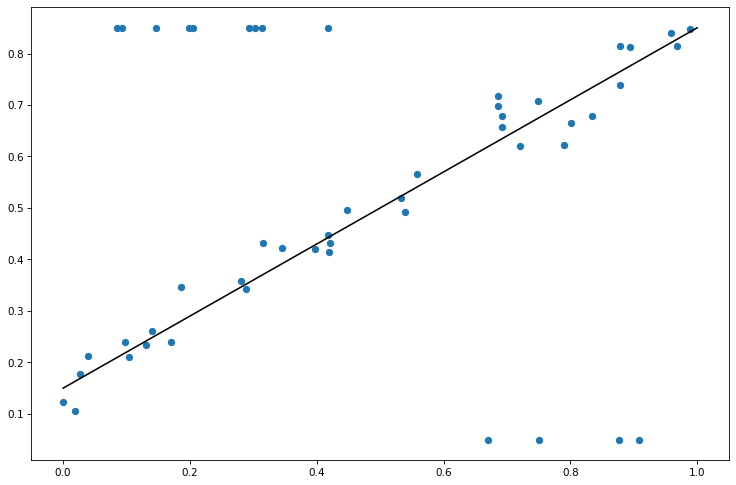

In [5]:
plt.figure(figsize=(12, 8), dpi=75)

plt.scatter(x, y)

plt.plot(x_plot, y_plot_true, color='k')

In [6]:
class RegressionModel(torch.nn.Module): 
    # A simple linear regression module.
    def __init__(self): 
        super(RegressionModel, self).__init__() 
        self.linear = torch.nn.Linear(1, 1)
    def forward(self, x): 
        return self.linear(x[:,None])[:,0]

In [7]:
def train_regression_and_plot():
    # Fit a linear regression using mean squared error.
    regression = RegressionModel() 
    params = regression.parameters()
    optimizer = torch.optim.Adam(params, lr = 0.01)

    fig, axes = plt.subplots(ncols=2, figsize=(18, 8), dpi=75)
    axes[0].set_ylim(0, 1)
    axes[0].set_xlim(0, 1)
    
    axes[1].set_ylim(0, 1)
    axes[1].set_xlim(-1, 1)
    
    camera = Camera(fig)

    for epoch in tqdm(range(1000)): 
        y_i = regression(x) 

        # Hijacking the general loss to compute MSE.
        loss = loss_fn(y_i, y).mean()

        if np.mod(epoch, 20) == 0:
            y_plot = regression(torch.Tensor(x_plot)).detach().numpy()
            axes[0].scatter(x, y, c='b')
            axes[0].plot(x_plot, y_plot_true, color='k')
            axes[0].plot(x_plot, y_plot, color='g')
            axes[0].text(0.5, 1.01, 'Epoch {}, loss={:03f}'.format(epoch, loss.data), transform=axes[0].transAxes)

            axes[1].plot(y_diff_plot, residue_plot, c='b')
            axes[1].scatter((y_i - y).detach().numpy(), loss_fn(y_i, y).detach().numpy(), color='g')
            camera.snap()
            # break

        optimizer.zero_grad() 
        loss.backward() 
        optimizer.step()

    animation = camera.animate()
    plt.close()
    return animation

# 1. Как выбирать $\rho$?


$$\arg\min \sum_i~\rho\left(f_{\theta}(x_i) - y_i\right)$$

 - робастный, 
 - адаптивный,
 - общий.

## 1.1 MSE

In [8]:
loss_fn = lambda y, y_true: (y - y_true).pow(2)

y_diff_plot = torch.linspace(-1, 1, 100)
residue_plot = (y_diff_plot**2).numpy()

animation = train_regression_and_plot()

HTML(animation.to_jshtml())

100%|██████████| 1000/1000 [00:00<00:00, 4626.56it/s]


## 1.2 MAE

In [9]:
loss_fn = lambda y, y_true: (y - y_true).abs()

y_diff_plot = torch.linspace(-1, 1, 100)
residue_plot = (y_diff_plot.abs()).numpy()

animation = train_regression_and_plot()

HTML(animation.to_jshtml())

100%|██████████| 1000/1000 [00:00<00:00, 4588.15it/s]


## 1.3 Pseudo-Huber loss

In [10]:
param_a = 1.

loss_fn = lambda y, y_true: (y - y_true).pow(2) * ((1 + (param_a / (y - y_true)).pow(2)).sqrt() - 1)

y_diff_plot = torch.linspace(-1, 1, 100)
residue_plot = (loss_fn(y_diff_plot, 0)).numpy()

animation = train_regression_and_plot()

HTML(animation.to_jshtml())

100%|██████████| 1000/1000 [00:00<00:00, 2929.66it/s]


# 2. A General and Adaptive Robust Loss Function

\begin{equation}
\mathcal{L}(x, \alpha, c) = \frac{|\alpha - 2|} {\alpha} \left( \left( {\left( \frac{x}{c} \right)^2 \over |\alpha - 2| } + 1 \right)^{\frac{\alpha}{2}} - 1 \right)
\end{equation}

In [11]:
loss_fn = lambda diff, alpha, c: ((alpha - 2).abs() / alpha) * (( (diff / c).pow(2) / (alpha - 2).abs() +1 ).pow(alpha / 2) - 1)

In [12]:
y_diff_plot = torch.linspace(-1, 1, 1000)

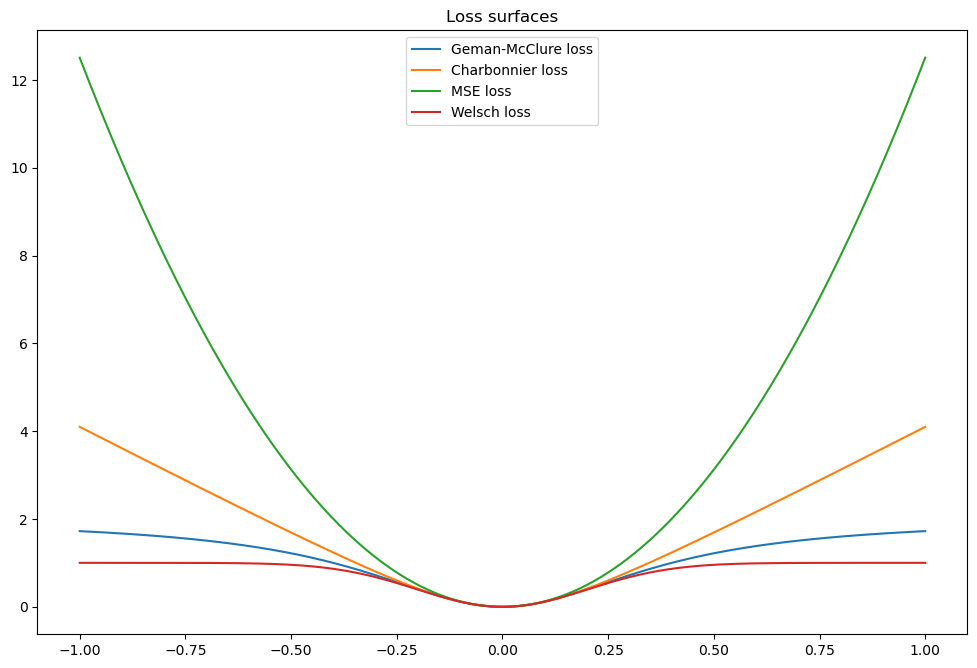

In [13]:
plt.figure(figsize=(12, 8), dpi=100)
plt.title("Loss surfaces")

plt.plot(y_diff_plot, loss_fn(y_diff_plot, torch.tensor(-2), torch.tensor(0.2)), label='Geman-McClure loss')
plt.plot(y_diff_plot, loss_fn(y_diff_plot, torch.tensor(1), torch.tensor(0.2)), label='Charbonnier loss')
plt.plot(y_diff_plot, loss_fn(y_diff_plot, torch.tensor(2.0001), torch.tensor(0.2)), label='MSE loss')
plt.plot(y_diff_plot, loss_fn(y_diff_plot, torch.tensor(-1000), torch.tensor(0.2)), label='Welsch loss')
plt.legend()

plt.show()

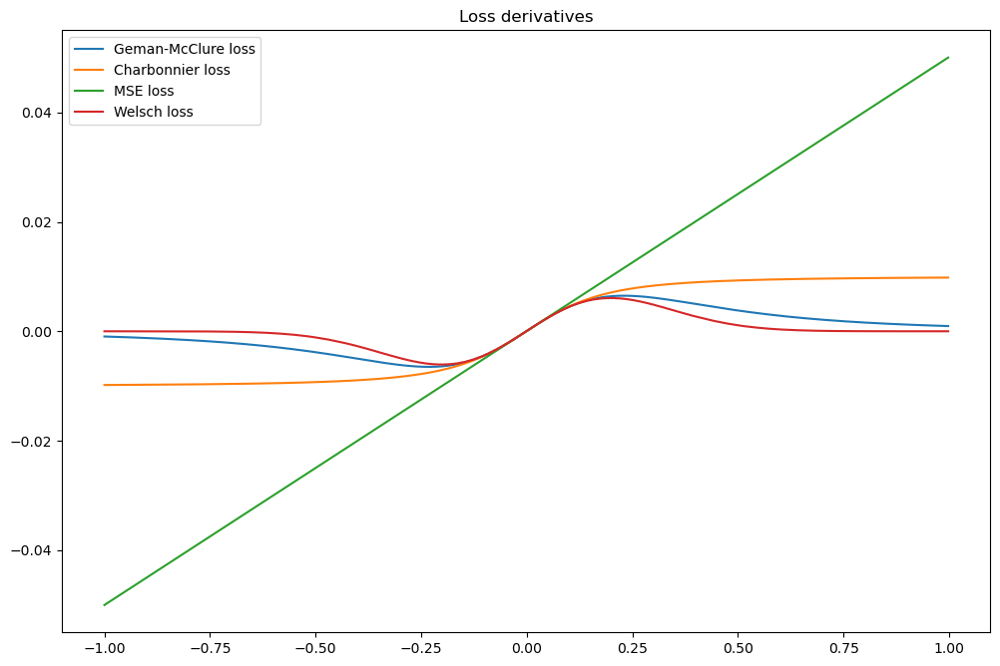

In [14]:
plt.figure(figsize=(12, 8), dpi=100)
plt.title("Loss derivatives")

plt.plot(y_diff_plot[:-1], loss_fn(y_diff_plot, torch.tensor(-2), torch.tensor(0.2)).diff(), label='Geman-McClure loss')
plt.plot(y_diff_plot[:-1], loss_fn(y_diff_plot, torch.tensor(1), torch.tensor(0.2)).diff(), label='Charbonnier loss')
plt.plot(y_diff_plot[:-1], loss_fn(y_diff_plot, torch.tensor(2.0001), torch.tensor(0.2)).diff(), label='MSE loss')
plt.plot(y_diff_plot[:-1], loss_fn(y_diff_plot, torch.tensor(-1000), torch.tensor(0.2)).diff(), label='Welsch loss')
plt.legend()

plt.show()

## 1.1 Оптимизация

In [15]:
loss_fn = lambda diff, alpha, c: ((alpha - 2).abs() / alpha) * (( (diff / c).pow(2) / (alpha - 2).abs() +1 ).pow(alpha / 2) - 1)

In [16]:
def train_regression_and_plot():
    # Fit a linear regression using mean squared error.
    regression = RegressionModel() 
    params = regression.parameters()
    alpha = torch.tensor(3., requires_grad=True)
    c = torch.tensor(1., requires_grad=True)
    optimizer = torch.optim.Adam(list(params) + [alpha] + [c], lr = 0.1)

    fig, axes = plt.subplots(ncols=2, figsize=(18, 8), dpi=75)
    axes[0].set_ylim(0, 1)
    axes[0].set_xlim(0, 1)
    
    axes[1].set_ylim(0, 1)
    axes[1].set_xlim(-1, 1)
    
    camera = Camera(fig)

    for epoch in tqdm(range(1000)): 
        y_i = regression(x) 

        # Hijacking the general loss to compute MSE.
        loss = loss_fn(y_i - y, alpha, c).mean()

        if np.mod(epoch, 20) == 0:
            y_plot = regression(torch.Tensor(x_plot)).detach().numpy()
            axes[0].scatter(x, y, c='b')
            axes[0].plot(x_plot, y_plot_true, color='k')
            axes[0].plot(x_plot, y_plot, color='g')
            axes[0].text(0.5, 1.01, 'Epoch {}, loss={:03f}'.format(epoch, loss.data), transform=axes[0].transAxes)
            
            residue_plot = (loss_fn(y_diff_plot, alpha, c)).detach().numpy()
            axes[1].plot(y_diff_plot, residue_plot, c='b')
            axes[1].scatter((y_i - y).detach().numpy(), loss_fn(y_i - y, alpha, c).detach().numpy(), color='g')
            camera.snap()
            # break

        optimizer.zero_grad() 
        loss.backward() 
        optimizer.step()

    animation = camera.animate()
    plt.close()
    print(alpha, c)
    return animation

In [17]:
y_diff_plot = torch.linspace(-3, 3, 100)

animation = train_regression_and_plot()

HTML(animation.to_jshtml())

100%|██████████| 1000/1000 [00:00<00:00, 2481.03it/s]


tensor(1.4629, requires_grad=True) tensor(6.4532, requires_grad=True)


## 1.2 Регуляризация

$$- \log p(x | \alpha) = \rho(x, \alpha) + \log Z(\alpha)$$

In [20]:
adaptive = robust_loss_pytorch.adaptive.AdaptiveLossFunction(num_dims = 1, 
                                                             float_dtype=np.float32, device='cpu')
print(adaptive.alpha(), adaptive.scale())
def train_regression_and_plot():
    # Fit a linear regression using mean squared error.
    regression = RegressionModel() 
    optimizer = torch.optim.Adam(list(regression.parameters()) + list(adaptive.parameters()), lr = 0.01)

    fig, axes = plt.subplots(ncols=2, figsize=(18, 8), dpi=75)
    axes[0].set_ylim(0, 1)
    axes[0].set_xlim(0, 1)
    
    axes[1].set_ylim(-2, 5)
    axes[1].set_xlim(-3, 3)
    
    camera = Camera(fig)

    for epoch in tqdm(range(5000)): 
        y_i = regression(x) 

        # Stealthily unsqueeze to an (n,1) matrix, and then compute the loss.
        # A matrix with this shape corresponds to a loss where there's one shape+scale parameter
        # per dimension (and there's only one dimension for this data).
        loss = torch.mean(adaptive.lossfun((y_i - y)[:,None]))

        if np.mod(epoch, 20) == 0:
            y_plot = regression(torch.Tensor(x_plot)).detach().numpy()
            axes[0].scatter(x, y, c='b')
            axes[0].plot(x_plot, y_plot_true, color='k')
            axes[0].plot(x_plot, y_plot, color='g')
            axes[0].text(0.5, 1.01, 'Epoch {}, loss={:03f}'.format(epoch, loss.data), transform=axes[0].transAxes)
            
            residue_plot = adaptive.lossfun(y_diff_plot[:,None])[:, 0].detach().numpy()
            axes[1].plot(y_diff_plot, residue_plot, c='b')
            axes[1].scatter((y_i - y).detach().numpy(), adaptive.lossfun((y_i - y)[:,None])[:, 0].detach().numpy(), color='g')
            camera.snap()
            # break

        optimizer.zero_grad() 
        loss.backward() 
        optimizer.step()

    animation = camera.animate()
    plt.close()
    return animation



tensor([[1.0000]], grad_fn=<AddBackward0>) tensor([[1.]], grad_fn=<AddBackward0>)


In [21]:
y_diff_plot = torch.linspace(-3, 3, 100)

animation = train_regression_and_plot()

HTML(animation.to_jshtml())

100%|██████████| 5000/5000 [00:04<00:00, 1098.34it/s]


In [ ]:
adaptive.alpha(), adaptive.scale()